In [1]:
using PlotlyJS, Statistics, BenchmarkTools, DataFrames, JSON, StatsBase, Random, Distributions, KernelDensity, ProgressBars, CSV, DataFramesMeta, PlotlyBase, DataStructures

in

## Creating & Validating the Attraction-Repulsion Model

In [3]:
agents1::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents1, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end

agents2::Vector{Agent} = []
for i in 1:100
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents2, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end

compareHists(agents1, "Ideological", agents2, "Affective", [0, 1000, 2500], true, true)

data: [
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis"
]

layout: "layout with fields annotations, barmode, height, margin, showlegend, template, width, xaxis, xaxis2, xaxis3, xaxis4, xaxis5, xaxis6, yaxis, yaxis2, yaxis3, yaxis4, yaxis5, and yaxis6"

In [4]:
open("base_res.json", "r") do f
    global id_results = JSON.parse(f)
end;

open("ad_h_affect_results.json", "r") do f
    global af_results = JSON.parse(f)
end;

## Comparing Tolerance

In [5]:
series_list = [
    searchRes(id_results, .1, .05, .25), 
    searchRes(id_results, .1, .15, .25), 
    searchRes(id_results, .1, .25, .25),
    searchRes(id_results, .1, .35, .25), 
    searchRes(id_results, .1, .45, .25), 
    searchRes(id_results, .1, .55, .25),
    searchRes(id_results, .1, .65, .25),
    searchRes(id_results, .1, .75, .25),
    searchRes(id_results, .1, .85, .25),
    searchRes(id_results, .1, .95, .25)
]
compareSeries(series_list)

data: [
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y"
]

layout: "layout with fields height, margin, template, and width"

In [6]:
series_list = [
    searchRes(af_results, .15, .05, .25), 
    searchRes(af_results, .15, .15, .25), 
    searchRes(af_results, .15, .25, .25),
    searchRes(af_results, .15, .35, .25), 
    searchRes(af_results, .15, .45, .25), 
    searchRes(af_results, .15, .55, .25),
    searchRes(af_results, .15, .65, .25),
    searchRes(af_results, .15, .75, .25),
    searchRes(af_results, .15, .85, .25),
    searchRes(af_results, .15, .95, .25)
]
compareSeries(series_list)

data: [
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y",
  "scatter with fields name, type, x, and y"
]

layout: "layout with fields height, margin, template, and width"

## Visualize Polarization

In [7]:
agents1::Vector{Agent} = []
group = 'B'
for i in 1:100
    group = 'B' == group ? 'A' : 'B'
    mean = group == 'B' ? .45 : .55
    push!(agents1, Agent(i, limit(randn() / 5 + mean, "norm"), .05, .4, .1, group))
end
res = runARM(500, agents1, false, true);

p = plot()
res_mat = hcat(res...)

A_group = []
B_group = []

for i in 1:size(res_mat,1)
    color = agents1[i].group == 'A' ? "red" : "blue"
    if color == "red"
        push!(A_group, res_mat[i,:])
    else
        push!(B_group, res_mat[i,:])
    end
    trace = scatter(x=1:length(res_mat[i,:]), y=res_mat[i,:], mode="markers", marker_color=color, opacity=.2)
    add_trace!(p, trace)
end

A_mean = mean(A_group, dims=1)[1]
B_mean = mean(B_group, dims=1)[1]
total_mean = (A_mean .+ B_mean) ./ 2

A_trace = scatter(x=1:length(res_mat[1,:]), y=A_mean, mode="lines", marker_color="red", opacity=1)
A_outline = scatter(x=1:length(res_mat[1,:]), y=A_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, A_outline)
add_trace!(p, A_trace)

B_trace = scatter(x=1:length(res_mat[1,:]), y=B_mean, mode="lines", marker_color="blue", opacity=1)
B_outline = scatter(x=1:length(res_mat[1,:]), y=B_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, B_outline)
add_trace!(p, B_trace)

mean_trace = scatter(x=1:length(res_mat[1,:]), y=total_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, mean_trace)

relayout!(p, width=600, height=600, showlegend=false)

p

data: [
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, opacity, type, x, xaxis, y, 

In [8]:
agents1::Vector{Agent} = []
for i in 1:10
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents1, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end

agents2::Vector{Agent} = []
for i in 1:10
    group = rand(['A','B'])
    mean = group == 'B' ? .45 : .55
    push!(agents2, Agent(i, limit(randn() / 5 + mean, "norm"), .1, .25, .25, group))
end


compareHists(agents1, "Ideological", agents2, "Affective", [0, 1000, 2500], true, true)

data: [
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis",
  "histogram with fields marker, nbinsx, opacity, type, x, xaxis, and yaxis"
]

layout: "layout with fields annotations, barmode, height, margin, showlegend, template, width, xaxis, xaxis2, xaxis3, xaxis4, xaxis5, xaxis6, yaxis, yaxis2, yaxis3, yaxis4, yaxis5, and yaxis6"

## Exposure by Response for T=.25,.45,.75

In [9]:
open("base_res.json", "r") do f
    global id_results = JSON.parse(f)
end;

open("ad_h_affect_results.json", "r") do f
    global ad_h_affect_results = JSON.parse(f)
end;

open("ad_affect_results.json", "r") do f
    global ad_affect_results = JSON.parse(f)
end;

open("h_affect_results.json", "r") do f
    global h_affect_results = JSON.parse(f)
end;

In [10]:
p = make_subplots(
      rows=2, 
      cols=2, 
      shared_xaxes=true,
      shared_yaxes=true,
    )

add_trace!(p, paramMap(id_results,  -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=1)
add_trace!(p, paramMap(h_affect_results, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=2)
add_trace!(p, paramMap(ad_affect_results, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=1)
add_trace!(p, paramMap(ad_h_affect_results, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=2)

relayout!(
      p, 
      showlegend=true, 
      width=500, 
      height=500,
      barmode="overlay"
    )

p

BoundsError: BoundsError: attempt to access 500-element Vector{Any} at index [10000]

## Simulations

In [11]:
function simulate(N::Int64, n_agents::Int64, cycles::Int64, affect_ad::Bool, affect_h::Bool, locked::Vector{Float64}=[-1., -1., -1.])
    
    results::Vector{Any} = zeros(N)
    lk = ReentrantLock()

    Threads.@threads for thread=1:N
        E = locked[1] == -1. ? rand(Beta(1,1)) : locked[1] 
        T = locked[2] == -1. ? rand(Beta(1,1)) : locked[2] 
        R = locked[3] == -1. ? rand(Beta(1,1)) : locked[3] 
        agents = [Agent(i, limit(randn() / 5 + .5, "norm"), E, T, R, rand(['A','B'])) for i=1:n_agents]
        res = [runARM(cycles, agents, affect_ad, affect_h)]
        lock(lk) do
            results[thread] = [E, T, R, res]
        end
    end

    return results

end 

simulate (generic function with 2 methods)

### Comparing Parameters for Random Simulations

In [12]:
sims = simulate(1000, 100, 500, false, false, [-1., -1., -1.])
id_sims = getAvgResults(sims);

sims = simulate(1000, 100, 500, true, false, [-1., -1., -1.])
ad_sims = getAvgResults(sims);

sims = simulate(1000, 100, 500, false, true, [-1., -1., -1.])
h_sims = getAvgResults(sims);

sims = simulate(1000, 100, 500, true, true, [-1., -1., -1.])
ad_h_sims = getAvgResults(sims);

In [13]:
p = make_subplots(
      rows=3, 
      cols=4, 
      shared_xaxes=true,
      shared_yaxes=true,
      column_titles=["I/I", "A/I", "I/A", "A/A"],
      row_titles=["E", "T", "R"]
    )

add_trace!(p, scatter(x=[s[1] for s in id_sims], y=[s[4][500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=1)
add_trace!(p, scatter(x=[s[1] for s in h_sims], y=[s[4][500] for s in h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=2)
add_trace!(p, scatter(x=[s[1] for s in ad_sims], y=[s[4][500] for s in ad_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=3)
add_trace!(p, scatter(x=[s[1] for s in ad_h_sims], y=[s[4][500] for s in ad_h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=1, col=4)

add_trace!(p, scatter(x=[s[2] for s in id_sims], y=[s[4][500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=1)
add_trace!(p, scatter(x=[s[2] for s in h_sims], y=[s[4][500] for s in h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=2)
add_trace!(p, scatter(x=[s[2] for s in ad_sims], y=[s[4][500] for s in ad_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=3)
add_trace!(p, scatter(x=[s[2] for s in ad_h_sims], y=[s[4][500] for s in ad_h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=2, col=4)

add_trace!(p, scatter(x=[s[3] for s in id_sims], y=[s[4][500] for s in id_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=1)
add_trace!(p, scatter(x=[s[3] for s in h_sims], y=[s[4][500] for s in h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=2)
add_trace!(p, scatter(x=[s[3] for s in ad_sims], y=[s[4][500] for s in ad_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=3)
add_trace!(p, scatter(x=[s[3] for s in ad_h_sims], y=[s[4][500] for s in ad_h_sims], mode="markers", marker=attr(opacity=.2), marker_color="blue"), row=3, col=4)

relayout!(
      p, 
      showlegend=false, 
      width=900, 
      height=800,
      barmode="overlay",
      xaxis_titles="steps"
    )

p

data: [
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, type, x, xaxis, y, and yaxis"
]

layout: "layout with fields annotations, barmode, height, margin, showlegend, template, width, xaxis, xaxis10, xaxis11, xaxis12, xaxis2, xaxis3, xaxis4, xaxis5, xaxis6, xaxis7, xaxis8, xaxis9, yaxis, yaxis10, yaxis11, yaxis12, yaxis2, yaxis3, yaxis4, yaxis5, yaxis6, yaxis7, yaxis8, and yaxis9"

### Simulation Based Inference

In [14]:
id_truth = getAvgResults(simulate(1, 100, 2500, false, true, [.25, .25, .25]))
af_truth = getAvgResults(simulate(1, 100, 2500, false, true, [.25, .25, .25]));

In [15]:
function distance(sample, truth)
    return sum((sample[1][4] - truth[1][4]).^2)
end

function plot_posterior(posterior::Vector{Float64}, truth::Float64)
    p = plot(histogram(x=posterior, nbinsx=100, range_x=[0,1]), Layout(xaxis_range=[0, 1], width=500))
    
    add_shape!(p, line(
        x0=mean(posterior), y0=0,
        x1=mean(posterior), y1=length(posterior),
        line=attr(color="Red", width=3),
    ))

    add_shape!(p, line(
        x0=truth, y0=0,
        x1=truth, y1=length(posterior),
        line=attr(color="Green", width=3),
    ))

    return p
end

function abc(truth::Vector{Any}, n_samples::Int64, threshold::Float64, affect_ad::Bool, affect_h::Bool, locked::Vector{Float64})
    
    posterior::Vector{Float64} = []
    for i in 1:n_samples
        dist = threshold + 1
        theta = 0
        while dist > threshold
            theta = rand(Beta(1,1))
            sample = getAvgResults(simulate(1, 100, 2500, affect_ad, affect_h, [theta, .25, .25]))
            dist = distance(truth, sample)
        end
        push!(posterior, theta)
    end
    return posterior
end

# https://link.springer.com/article/10.1007/s11222-011-9296-2
function metropolis_hastings(truth::Vector{Any}, n_samples::Int64, n_iters::Int64, affect_ad::Bool, affect_h::Bool, locked::Vector{Float64})

    thetas::Vector{Float64} = []
    distances::Vector{Float64} = []
    ctr = 0

    for i in 1:n_samples

        theta = rand(Beta(1,1))
        sample = getAvgResults(simulate(1, 100, 2500, affect_ad, affect_h, [theta, .25, .25]))
        dist = distance(truth, sample)
        
        push!(thetas, theta)
        push!(distances, dist)

    end

    theta_sets = [thetas]

    for i in 1:n_iters

        old_kde = kde(thetas, boundary=(0,1), bandwidth=.1)

        z = sample(old_kde.x, Weights(old_kde.density))
        z_sample = getAvgResults(simulate(1, 100, 2500, affect_ad, affect_h, [z, .25, .25]))
        z_dist = distance(truth, z_sample)

        n_index = rand(1:length(thetas))
        n = thetas[n_index]

        prop_thetas = copy(thetas)
        prop_thetas[n_index] = z
        prop_kde = kde(prop_thetas, boundary=(0,1), bandwidth=.1)

        z_kde = pdf(old_kde, z)
        n_kde = pdf(prop_kde, n)

        proxy_dist = (1 ./ distances) / sum(1 ./ distances)

        prop_distances = copy(distances)
        prop_distances[n_index] = z_dist
        prop_proxy_dist = (1 ./ prop_distances) / sum(1 ./ prop_distances)

        switch_prob = (prop_proxy_dist[n_index] * n_kde) / (proxy_dist[n_index] * z_kde)
        # switch_prob = prop_proxy_dist[n_index] / proxy_dist[n_index]

        if rand(Beta(1,1)) < min(1, switch_prob)
            ctr = ctr + 1
            thetas = prop_thetas
            distances = prop_distances
        end

        push!(theta_sets, thetas)

    end

    posterior = theta_sets[1]
    for i in 2:length(theta_sets)
        posterior = posterior .+ theta_sets[i]
    end

    return thetas
end


metropolis_hastings (generic function with 1 method)

In [16]:
posterior = abc(id_truth, 100, .1, false, false, [-1., .25, .25])
plot_posterior(posterior, .25)

data: [
  "histogram with fields nbinsx, range, type, and x"
]

layout: "layout with fields margin, shapes, template, width, and xaxis"

In [17]:
posterior = abc(af_truth, 30, .5, true, false, [-1., .25, .25])
plot_posterior(posterior, .25)

data: [
  "histogram with fields nbinsx, range, type, and x"
]

layout: "layout with fields margin, shapes, template, width, and xaxis"

In [18]:
posterior = metropolis_hastings(id_truth, 25, 1000, false, false, [-1., .25, .25])
plot_posterior(posterior, .25)

data: [
  "histogram with fields nbinsx, range, type, and x"
]

layout: "layout with fields margin, shapes, template, width, and xaxis"

In [19]:
posterior = metropolis_hastings(af_truth, 25, 1000, true, false, [-1., .25, .25])
plot_posterior(posterior, .25)

data: [
  "histogram with fields nbinsx, range, type, and x"
]

layout: "layout with fields margin, shapes, template, width, and xaxis"

### Analytical Exploration

In [20]:
ideological_exposure()

data: [
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields mode, name, type, x, and y",
  "scatter with fields line, mode, name, type, x, and y"
]

layout: "layout with fields margin, template, title, xaxis, and yaxis"

In [21]:
ideological_reaction(.5)

data: [
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis",
  "scatter with fields mode, type, x, xaxis, y, and yaxis"
]

layout: "layout with fields annotations, margin, showlegend, template, title, xaxis, xaxis2, xaxis3, yaxis, yaxis2, and yaxis3"

### ANES Data

In [22]:
df = CSV.read("raw_data/anes_timeseries_cdf_csv_20220916/anes_timeseries_cdf_csv_20220916.csv", DataFrame);

In [23]:
filtered_df = df[(df[:, "VCF0302"] .== "1") .| (df[:, "VCF0302"] .== "5"), :];

In [29]:
var_map = SortedDict{String, String}(
    "VCF0834" => "Women should be in the home?", # 7
    "VCF0838" => "Should abortion be legal?", #16
    "VCF0876a" => "Laws shouldn't protect homosexuality?", #9
    "VCF0879" => "Decrease number of immigrants?", #9
    "VCF9043" => "Should school prayer be allowed?", #7
    "VCF9237" => "Oppose death penalty?", #5
    "VCF9238" => "Should be easier to buy guns?", #6
    "VCF0830" => "Blacks shouldn't have aid?", #17
    "VCF0867a" => "Oppose Affirmative Action?", #12
    "VCF0815" => "Segregation", #6
    "VCF0817" => "There shouldn't be school busing for integration?", #5
    "VCF0842" => "Environmental Regulation is too burdensome?" #4
);

plots = []
p = make_subplots(
    rows=floor(Int, length(var_map) / 4), cols=4,
    shared_yaxes=true,
)

ctr = 0
full_results = Dict{String, Any}()
for variable in keys(var_map)

    res = get_series(filtered_df, variable)
    full_results[variable] = res
    traces = display_series(res, var_map)
    
    for t in traces
        add_trace!(p, t, row=floor(Int, ctr / 4) + 1, col=ctr % 4 + 1)
    end

    relayout!(p)
    ctr += 1

end

relayout!(p, showlegend=false, height=600)
p

data: [
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis",
  "scatter with fields marker, mode, name, type, x, xaxis, y, and yaxis"
]

layout: "layout with fields annotations, height, margin, showlegend, template, xaxis, xaxis10, xaxis11, xaxis12, xaxis2, xaxis3, xaxis4, xaxis5, xaxis6, xaxis7, xaxis8, xaxis9, yaxis, yaxis10, yaxis11, yaxis12, yaxis2, yaxis3, yaxis4, yaxis5, yaxis6, yaxis7, yaxis8, and yaxis9"

In [24]:
output = compare_results(.1, .25, .25, false, false, full_results, var_map, 20)

ErrorException: syntax: { } vector syntax is discontinued around /Users/matthewbone/Documents/Coding/VSCode/ARM-2D/julia/ARM-develop.ipynb:11

In [123]:
open("base_optimals.json", "r") do f
    global base_optimals = JSON.parse(f)
end;

open("id_optimals.json", "r") do f
    global id_optimals = JSON.parse(f)
end;

open("h_optimals.json", "r") do f
    global h_optimals = JSON.parse(f)
end;

open("id_h_optimals.json", "r") do f
    global id_h_optimals = JSON.parse(f)
end;

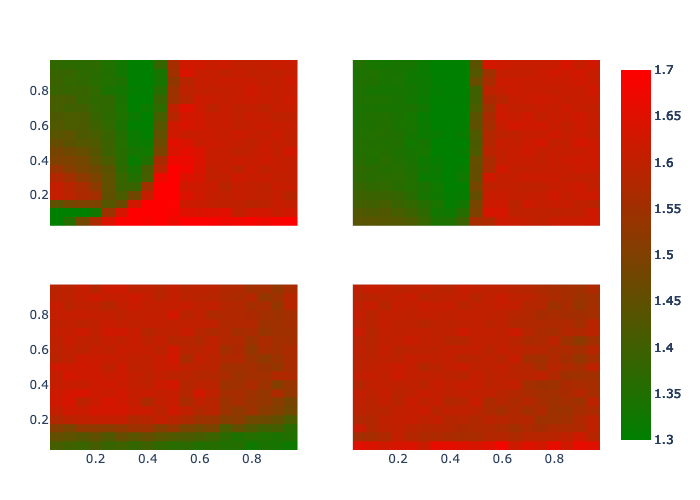

In [124]:
p = make_subplots(
      rows=2, 
      cols=2, 
      shared_xaxes=true,
      shared_yaxes=true,
    )

variable = "total"
add_trace!(p, optimalMap(base_optimals, variable,   -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=1)
add_trace!(p, optimalMap(h_optimals, variable, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=1, col=2)
add_trace!(p, optimalMap(id_optimals, variable, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=1)
add_trace!(p, optimalMap(id_h_optimals, variable, -1., -1., .25, [i for i in .05:.05:.95], [i for i in .05:.05:.95], true), row=2, col=2)

relayout!(
      p, 
      showlegend=true, 
      width=500, 
      height=500,
      barmode="overlay"
    )

p

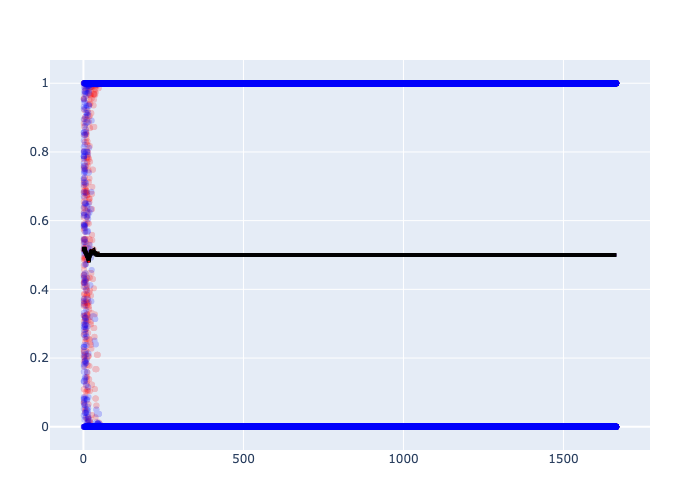

In [66]:
n_dems = floor(full_results["VCF0876a"]["stats"]["perc_dem"] * 100)
mean_dems = full_results["VCF0876a"]["dem_stats"]["mean"][1]
var_dems = full_results["VCF0876a"]["dem_stats"]["variance"][1]
mean_reps = full_results["VCF0876a"]["rep_stats"]["mean"][1]
var_reps = full_results["VCF0876a"]["rep_stats"]["variance"][1]

# one cycle is a week
n_steps = (full_results["VCF0876a"]["years"][end] - full_results["VCF0876a"]["years"][1]) * 52 + 1

agents::Vector{Agent} = []
for i in 1:100

    if i < n_dems
        push!(agents, Agent(i, limit(randn() * var_reps^.5 + mean_reps, "norm"), .6, .15, .25, 'A'))
    else
        push!(agents, Agent(i, limit(randn() * var_dems^.5 + mean_dems, "norm"), .6, .15, .25, 'B'))
    end

end
res = runARM(n_steps, agents, false, true);

p = plot()
res_mat = hcat(res...)

A_group = []
B_group = []

for i in 1:size(res_mat,1)
    color = agents[i].group == 'A' ? "red" : "blue"
    if color == "red"
        push!(A_group, res_mat[i,:])
    else
        push!(B_group, res_mat[i,:])
    end
    trace = scatter(x=1:length(res_mat[i,:]), y=res_mat[i,:], mode="markers", marker_color=color, opacity=.2)
    add_trace!(p, trace)
end

A_mean = mean(A_group, dims=1)[1]
B_mean = mean(B_group, dims=1)[1]
total_mean = (A_mean .+ B_mean) ./ 2

A_trace = scatter(x=1:length(res_mat[1,:]), y=A_mean, mode="lines", marker_color="red", opacity=1)
A_outline = scatter(x=1:length(res_mat[1,:]), y=A_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, A_outline)
add_trace!(p, A_trace)

B_trace = scatter(x=1:length(res_mat[1,:]), y=B_mean, mode="lines", marker_color="blue", opacity=1)
B_outline = scatter(x=1:length(res_mat[1,:]), y=B_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, B_outline)
add_trace!(p, B_trace)

mean_trace = scatter(x=1:length(res_mat[1,:]), y=total_mean, mode="lines", marker_color="black", opacity=1, line=(width=4,))
add_trace!(p, mean_trace)

relayout!(p, width=600, height=600, showlegend=false)

p